# Test the hologram performances with HD205905 data 05 juin 2017
==================================================================================================

- author : Sylvie
- date   : September 18th th 2017


Inspired from Jeremy's work on PN and QSO


#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better

In [2]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/ana_05jun17/HD205905


In [4]:
from astropy.modeling import models, fitting

# Input directory

In [5]:
#inputdir="../OverScanRemove/trim_images"
#inputdir="../../data/CTIODataJune2017_reducedRed/data_05jun17/"
inputdir="/Volumes/LaCie2/CTIODataJune2017_reducedRed/data_05jun17/"
MIN_IMGNUMBER=46
MAX_IMGNUMBER=126
date="20170605"
object_name='HD205905'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

# Output directory

In [6]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

# Location of the spectra

In [7]:
dirlist_all = [inputdir]
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 80


# Example for one image


the idea is to check where is the center of the main star

In [8]:
sel_index=2

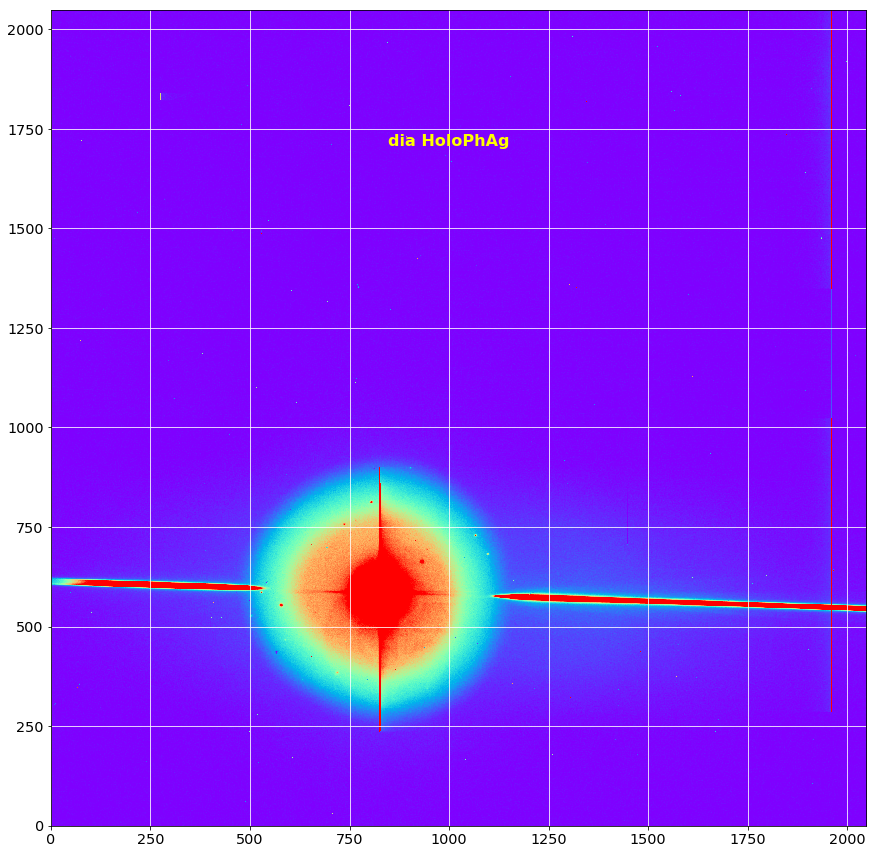

In [9]:
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=800)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

# Try to fit a 2D gaussian


In [10]:
x0=800
y0=600
dw=300

In [11]:
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [12]:
#plt.imshow(cropped_image,origin='lower',cmap='rainbow',vmin=0, vmax=1000)
#plt.grid(color='white', ls='solid')

In [13]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [14]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [15]:
z=cropped_image[y,x]

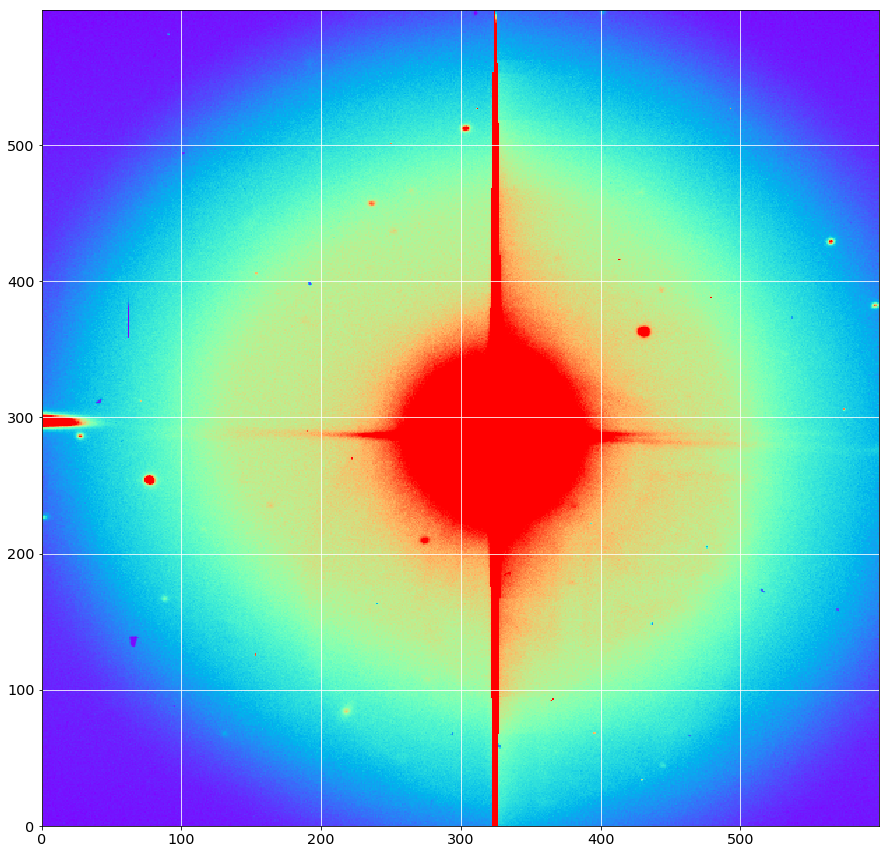

In [16]:
# plot x,y,z
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')

In [17]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

300 300 3721.35772316


In [18]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [19]:
#with warnings.catch_warnings():
#    # Ignore model linearity warning from the fitter
#    warnings.simplefilter('ignore')
#    p = fit_p(p_init, x, y, z)

In [20]:
import warnings
p = fit_p(p_init, x, y, z)

In [21]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=324.185069636)
Parameter('y_mean', value=280.497137671)
Parameter('amplitude', value=80553.0678821)


In [22]:
new_x0=p.x_mean
new_y0=p.y_mean

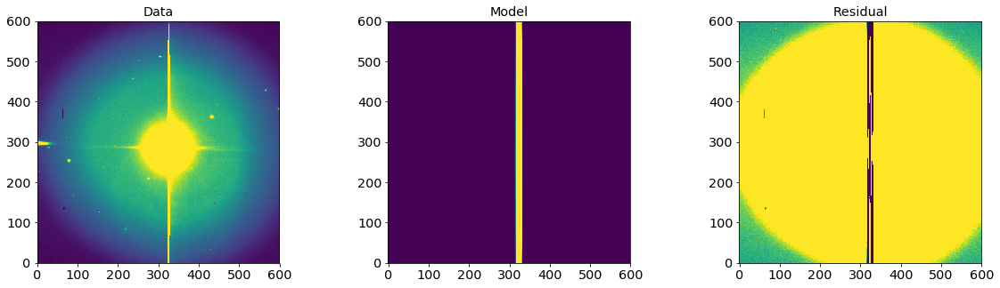

In [23]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.title("Data")
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,
           vmax=1000)
plt.title("Model")
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,
           vmax=100)
plt.title("Residual")

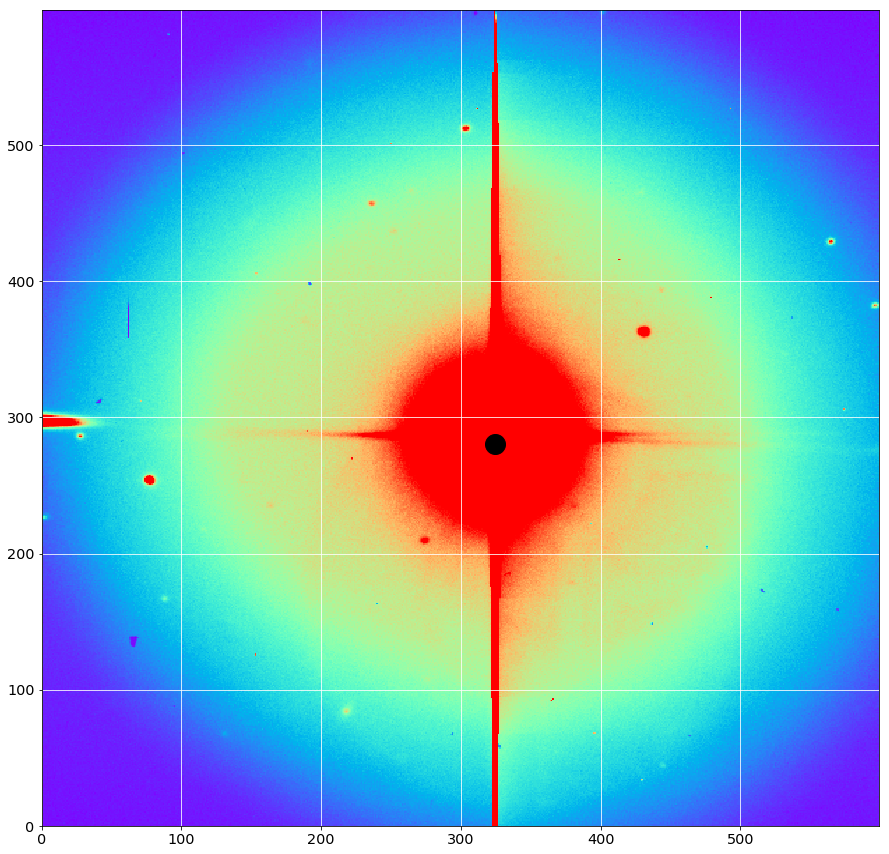

In [24]:
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=20)
plt.grid(color='white', ls='solid')

# Show the images

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

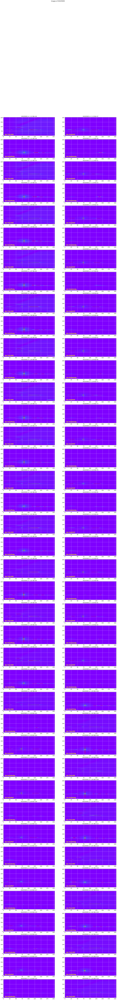

In [25]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

# Show the histograms

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

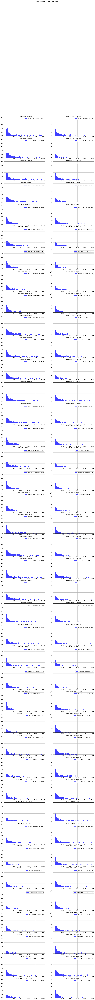

In [26]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

#  Guess central position


In [27]:
if 0:

    #x_guess = [900,900,755,755] valid only for three images
    #y_guess = [565,565,660,660]

    x_guess=[800]*len(all_images)
    y_guess=[600]*len(all_images)

    DeltaY=[100]*len(all_images)
    DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

    images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
    figfilename=os.path.join(dir_top_images,'cut_images.pdf')
    plt.savefig(figfilename)   

In [28]:
# guess the region where the maximum is
x0=800
y0=600
dw=300

x_guess = [] 
y_guess = []
index=0

for theimage in all_images:
    index+=1
    sub_image=np.copy(theimage[y0-dw:y0+dw,x0-dw:x0+dw])
    
    NY=cropped_image.shape[0]
    NX=cropped_image.shape[1]
    y, x = np.mgrid[:NY,:NX]
    z=sub_image[y,x]
    
    x_mean=NX/2
    y_mean=NY/2
    z_max=z[y_mean,x_mean]
    
    # do the gaussian fit
    p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
    fit_p = fitting.LevMarLSQFitter()
    
    p = fit_p(p_init, x, y, z)
    
    x_fit= p.x_mean
    y_fit= p.y_mean
    z_fit= p.amplitude
    
    print index,': (',x_fit,' , ',y_fit,' )'
    
    x_guess.append(x0-dw+x_fit)
    y_guess.append(y0-dw+y_fit)

x_guess=np.array(x_guess)
y_guess=np.array(y_guess)

1 : ( Parameter('x_mean', value=234.263223817)  ,  Parameter('y_mean', value=347.434762703)  )
2 : ( Parameter('x_mean', value=234.024027644)  ,  Parameter('y_mean', value=342.423864547)  )
3 : ( Parameter('x_mean', value=324.185069636)  ,  Parameter('y_mean', value=280.497137671)  )
4 : ( Parameter('x_mean', value=323.627441378)  ,  Parameter('y_mean', value=285.839912558)  )
5 : ( Parameter('x_mean', value=231.749796858)  ,  Parameter('y_mean', value=345.557433611)  )
6 : ( Parameter('x_mean', value=232.665585408)  ,  Parameter('y_mean', value=340.906740763)  )
7 : ( Parameter('x_mean', value=322.711650937)  ,  Parameter('y_mean', value=268.443302411)  )
8 : ( Parameter('x_mean', value=321.857432126)  ,  Parameter('y_mean', value=283.313205593)  )
9 : ( Parameter('x_mean', value=232.137158873)  ,  Parameter('y_mean', value=343.196822948)  )
10 : ( Parameter('x_mean', value=231.45998908)  ,  Parameter('y_mean', value=333.292255308)  )
11 : ( Parameter('x_mean', value=322.31908534)  , 

In [29]:
print x_guess

[  734.26322382   734.02402764   824.18506964   823.62744138   731.74979686
   732.66558541   822.71165094   821.85743213   732.13715887   731.45998908
   822.31908534   820.37274157   730.70158771   730.94427387   821.00351975
   820.41453508   729.61386261   728.69893394   820.13867653   819.42818418
   728.59669073   728.07607691   819.10842295   818.42745919   727.18388027
   727.37582651   819.31831872   817.87165676   726.71009875   727.93771611
   817.94740163   816.48751042   725.79025805   725.75138604   815.8525185
   814.35135071   723.84302744   722.88867831   814.4005326    812.75532301
   720.8507098    720.70662745   810.67987905   809.77122465   719.5746106
   718.89933536   809.3865324    808.02102037  1063.00200538   716.13297198
   806.05626646   804.88381172   714.46423452   803.09181651   802.16905657
  1062.60815678   710.70772314   800.36385322   799.37688425  1062.0510069
   708.67251901   800.72830169   798.12656695   707.79516128   707.08225278
   797.96503537

In [30]:
print y_guess

[ 647.4347627   642.42386455  580.49713767  585.83991256  645.55743361
  640.90674076  568.44330241  583.31320559  643.19682295  633.29225531
  564.54174025  580.62298553  641.1567585   629.18877621  565.32086982
  579.26478768  639.69166332  633.12351764  564.49108264  577.6176474
  637.74455605  623.12264291  564.91653855  575.66358487  635.07005012
  626.78666595  560.47168897  573.41762635  632.02448932  623.45783919
  557.67471918  570.10195801  631.03947039  624.8602536   562.21940053
  569.7125819   629.42941135  624.59090621  560.52774649  567.90329277
  627.9140028   620.54723664  551.32049389  565.967555    624.90684775
  614.83509074  552.16742565  565.74575063  624.83002936  617.67670124
  545.78620523  565.11389219  624.86512021  551.90485583  563.44555975
  620.05794764  607.19776926  543.82955166  560.99374546  617.90863899
  610.1958656   541.69929464  560.19985343  618.05390024  607.31637575
  529.63305231  556.57292369  612.51261842  605.95493472  536.31818289
  554.5

# Cut image

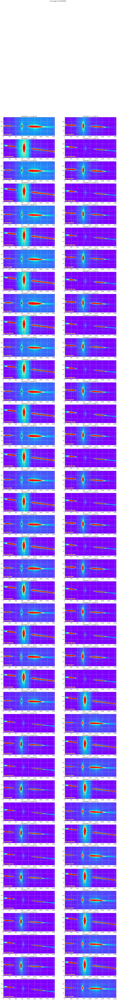

In [31]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

# Save cut images

In [32]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_046.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_047.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_048.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_049.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_050.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_051.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_052.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_20170605_053.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Sep 19 17:13 cut_fitsimages/cutimg_2

# Find the optimal rotation of the spectra
============================

In [33]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 80


## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

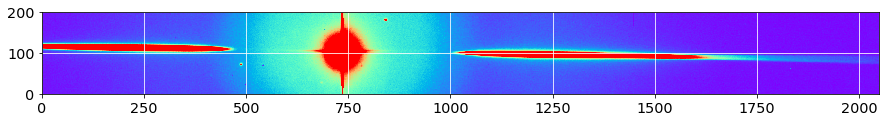

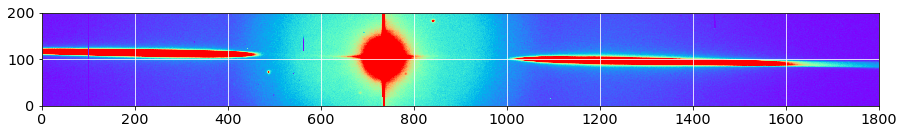

In [34]:
sel=1
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

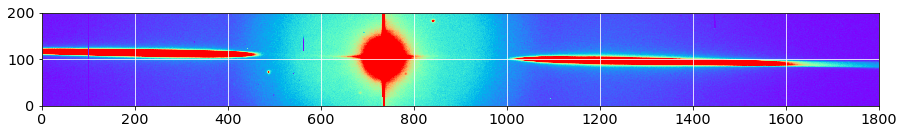

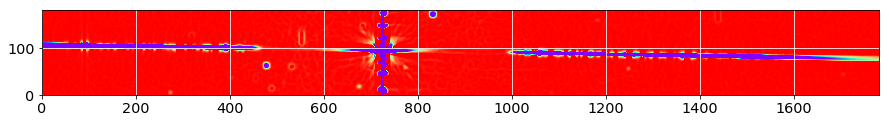

In [35]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Number of remaining pixels : 18312


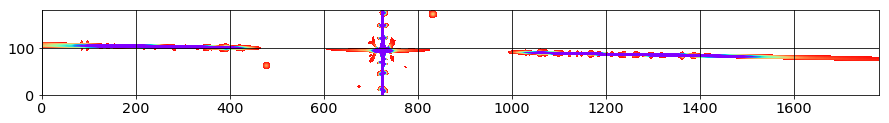

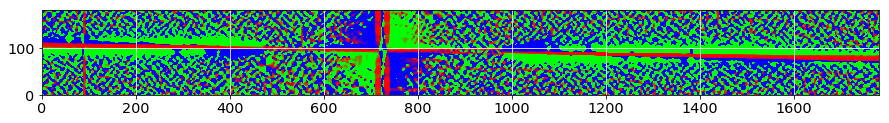

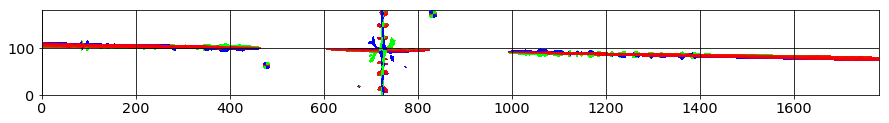

In [36]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

Number of remaining pixels : 12741


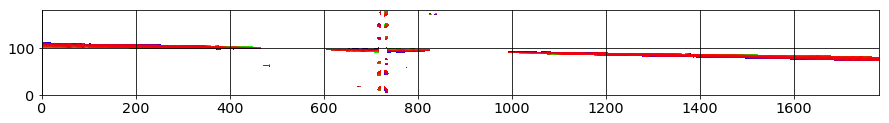

In [37]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.929390495674


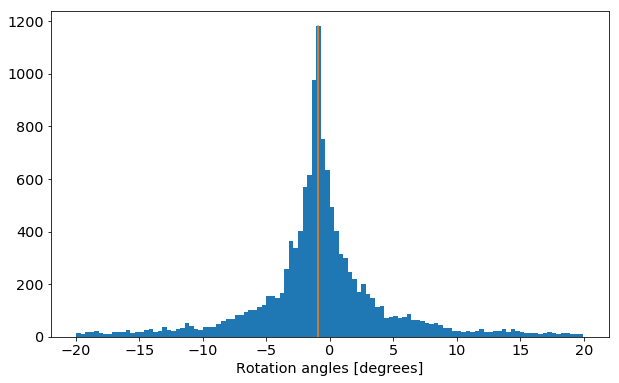

In [38]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

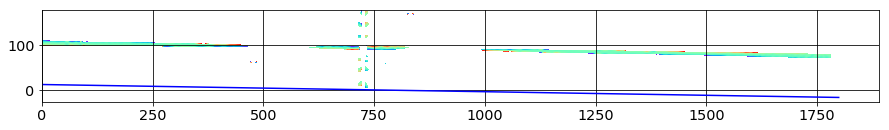

In [39]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()

Rotation angle from fit : -0.924688752094


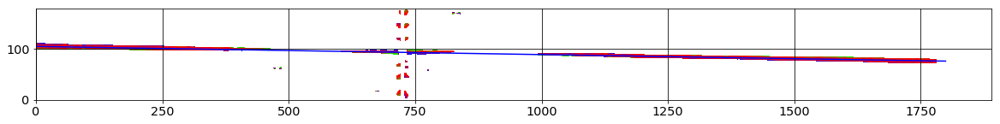

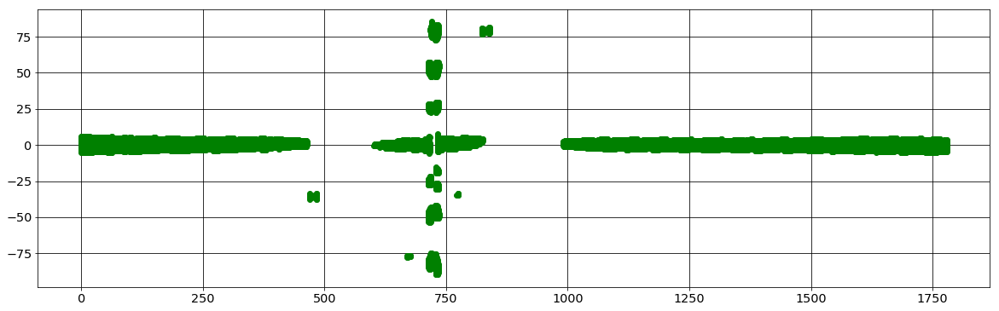

In [40]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Using Hessian theta angles:
0  theta =  -0.47222993739
1  theta =  -0.964870623171
2  theta =  -1.85225912042
3  theta =  -1.41772612896
4  theta =  -0.47998432295
5  theta =  -0.97187531976
6  theta =  -1.94883693393
7  theta =  -1.44398056637
8  theta =  -0.453661565407
9  theta =  -0.956019095015
10  theta =  -2.0063250211
11  theta =  -1.45454768332
12  theta =  -0.44472615403
13  theta =  -0.992763495364
14  theta =  -1.91567493968
15  theta =  -1.47341061551
16  theta =  -0.473608450208
17  theta =  -0.969183774679
18  theta =  -1.89080361729
19  theta =  -1.46723087792
20  theta =  -0.450804274729
21  theta =  -0.958609774212
22  theta =  -1.87435228789
23  theta =  -1.50089885114
24  theta =  -0.467014533692
25  theta =  -0.984344681348
26  theta =  -1.9062890416
27  theta =  -1.46002597995
28  theta =  -0.440967763505
29  theta =  -0.987911975473
30  theta =  -1.92277331271
31  theta =  -1.49210983375
32  theta =  -0.484053277745
33  theta =  -0.984929244293
34  theta =  -1.88

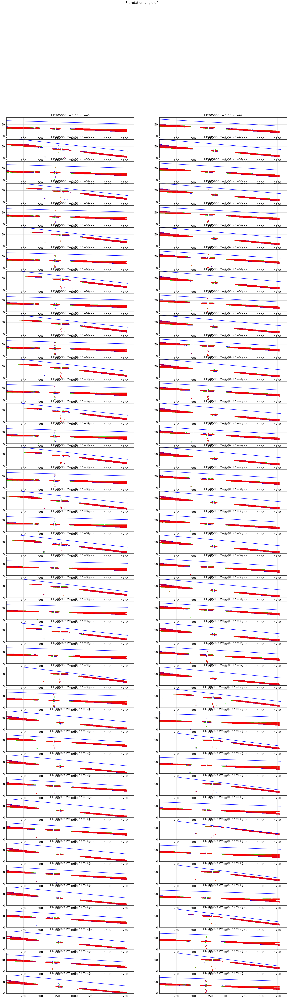

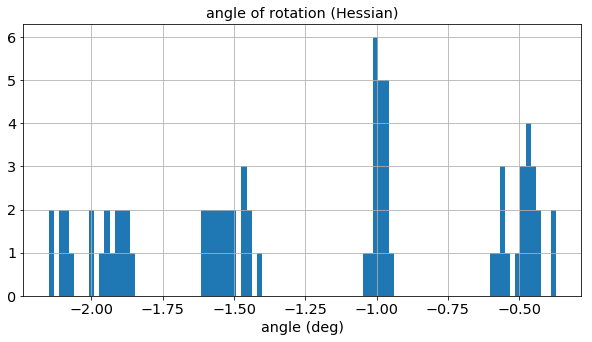

In [41]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')